In [119]:
import pandas as pd
import numpy as np
from bertopic import BERTopic
import matplotlib.pyplot as plt
from sentence_transformers import SentenceTransformer
from sklearn.metrics.pairwise import cosine_similarity
from BERTopicTools.CosineSimilarityTools import CosineSimilarityTools
import plotly.express as px
from plotly.offline import init_notebook_mode, iplot
import plotly.graph_objs as go
from umap import UMAP
from copy import deepcopy
import pickle
from scipy.stats import entropy

In [85]:
df = pd.read_csv("nyt_articles_for_bert.csv")
docs = df['doc'].tolist()

df['pub_date'] = pd.to_datetime(df['pub_date'])
df['year'] = df['pub_date'].dt.year
df['month'] = df['pub_date'].dt.strftime('%Y-%m')

In [86]:
# topic_model = BERTopic(language="english",calculate_probabilities=True,verbose=True)
# topics, probs = topic_model.fit_transform(docs)
# # Save the model to a file
# with open('BERT_model.pkl', 'wb') as file:
#     pickle.dump(topic_model, file)

In [87]:
# Load the model from the file
with open('BERT_model.pkl', 'rb') as file:
    topic_model = pickle.load(file)

## 1. Look into the hierarchical structure

In [89]:
topic_model.hierarchical_topics(docs)

100%|████████████████████████████████████████| 139/139 [00:00<00:00, 378.78it/s]


### 1.1. plot the tree diagram

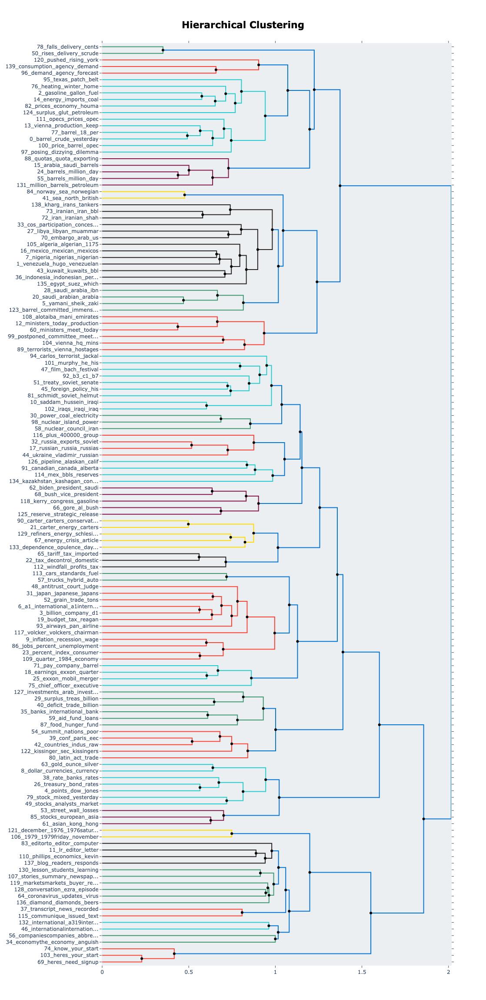

In [90]:
topic_model.visualize_hierarchy(hierarchical_topics = hierarchical_topics)

### 1.2. Export the parent node information

In [91]:
df_hierarchy = topic_model.hierarchical_topics(docs)
df_hierarchy.to_csv("topic_hierarchy.csv")
df_hierarchy.head(3)

100%|████████████████████████████████████████| 139/139 [00:00<00:00, 390.81it/s]


,Parent_ID,Parent_Name,Topics,Child_Left_ID,Child_Left_Name,Child_Right_ID,Child_Right_Name,Distance
138,278,the_to_of_in_and,"[0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13,...",273,oil_crude_prices_barrel_price,277,the_and_to_in_of,2.015702
137,277,the_and_to_in_of,"[3, 4, 6, 8, 9, 10, 11, 17, 18, 19, 21, 22, 23...",276,the_and_to_in_of,275,you_heres_your_know_need,1.856556
136,276,the_and_to_in_of,"[3, 4, 6, 8, 9, 10, 17, 18, 19, 21, 22, 23, 25...",274,the_and_to_of_in,256,dollar_points_stock_rates_stocks,1.600826


## 2. Annotate topic into to the documents

In [92]:
topics, probs = topic_model.transform(docs)

Batches:   0%|          | 0/306 [00:00<?, ?it/s]

### 2.1. Low topic index - the leaf node

In [93]:
# Step 1: Create the 'lowest_topic_index' column
df['low_topic_index'] = topics

# Step 2: Create the 'lowest_topic_name' column
topic_names = []
# Iterate over each topic in the topics list
for topic in topics:
    words = topic_model.get_topic(topic)
    topic_name = '_'.join([word for word, _ in words])
    topic_names.append(topic_name)

# Assign the topic names to the new column
df['low_topic_name'] = topic_names

### 2.2. High topic index - the parent nodes with the same color
    - not sure of the threshold cosine simliarity value for the same colors..

In [94]:
# parent ids
parent_ids = [141, 231, 261, 194, 146, 246, 214, 235, 244, 223, 226, 247, 230, 225, 189, 190, 264, 224, 234, 221, 238, 185, 203, 245, 248, 211, 242, 250, 142]

# Initialize the new columns with default values
df['high_topic_index'] = None
df['high_topic_name'] = None

# Iterate over each parent_id in parent_ids
for parent_id in parent_ids:
    # Find the row in df_hierarchy that matches the parent_id
    hierarchy_row = df_hierarchy[df_hierarchy['Parent_ID'] == str(parent_id)]

    # If there is a matching row, proceed
    if not hierarchy_row.empty:
        # Extract the Parent_Name and Topics from the hierarchy row
        parent_name = hierarchy_row['Parent_Name'].values[0]
        topics = hierarchy_row['Topics'].values[0]

        # Iterate over each topic in the Topics column
        for topic in topics:
            # Find rows in df where the lowest_topic_index matches the current topic
            df.loc[df['low_topic_index'] == topic, 'high_topic_index'] = parent_id
            df.loc[df['low_topic_index'] == topic, 'high_topic_name'] = parent_name
    else: 
        print("hi")


In [95]:
df.head(3)

,Unnamed: 0,abstract,web_url,snippet,lead_paragraph,print_section,print_page,pub_date,_id,word_count,uri,doc,year,month,low_topic_index,low_topic_name,high_topic_index,high_topic_name
0,0,Petroleum Exporting Countries Orgn (OPEC) conf...,https://www.nytimes.com/1961/02/15/archives/wo...,Petroleum Exporting Countries Orgn (OPEC) conf...,NaN,business financial,49.0,1961-02-15 05:00:00+00:00,nyt://article/6cd91ec1-77f8-52a5-b7ee-9937a6ec...,0,nyt://article/6cd91ec1-77f8-52a5-b7ee-9937a6ec...,Petroleum Exporting Countries Orgn (OPEC) conf...,1961,1961-02,1,venezuela_hugo_venezuelan_chavez_venezuelas_ch...,246,venezuela_oil_hugo_price_of
1,1,Min Perez Alfonzo (Venezuela) on way to USSR t...,https://www.nytimes.com/1961/07/29/archives/be...,Min Perez Alfonzo (Venezuela) on way to USSR t...,NaN,BUSINESS FINANCIAL,23.0,1961-07-29 05:00:00+00:00,nyt://article/8abf4ee1-8531-5bbf-9bee-6588ccc0...,0,nyt://article/8abf4ee1-8531-5bbf-9bee-6588ccc0...,Min Perez Alfonzo (Venezuela) on way to USSR t...,1961,1961-07,1,venezuela_hugo_venezuelan_chavez_venezuelas_ch...,246,venezuela_oil_hugo_price_of
2,2,Venezuela backs Iraqi plea to postpone OPEC co...,https://www.nytimes.com/1961/08/08/archives/ca...,Venezuela backs Iraqi plea to postpone OPEC co...,NaN,BUSINESS FINANCIAL,40.0,1961-08-08 05:00:00+00:00,nyt://article/7bbaaae0-3ae6-5c52-851a-f10d8e5e...,0,nyt://article/7bbaaae0-3ae6-5c52-851a-f10d8e5e...,Venezuela backs Iraqi plea to postpone OPEC co...,1961,1961-08,1,venezuela_hugo_venezuelan_chavez_venezuelas_ch...,246,venezuela_oil_hugo_price_of


## 3. Plot the time trend of each high level topic

### Declare the function for plotting

In [160]:
def plot_counts_by_time_unit(df, time_unit):
    # Check if the time_unit is valid
    if time_unit not in ['year', 'month']:
        raise ValueError("Invalid time_unit. Use 'year' or 'month'.")

    # Determine the time column based on the time_unit argument
    time_column = 'year' if time_unit == 'year' else 'month'

    # Extract the time component from the selected time_column
    if time_unit == 'year':
        df['time_component'] = df[time_column]
    elif time_unit == 'month':
        df['time_component'] = pd.to_datetime(df[time_column], format='%Y-%m')

    # Get unique values of "high_topic_index" and "high_topic_name"
    unique_high_topics = df[['high_topic_index', 'high_topic_name']].drop_duplicates()

    # Loop through each unique combination of index and name and create plots
    for idx, row in unique_high_topics.iterrows():
        high_topic_index = row['high_topic_index']
        high_topic_name = row['high_topic_name']

        # Filter rows where high_topic_index matches the current value
        filtered_df = df[df['high_topic_index'] == high_topic_index]

        # Group by time component and get counts
        counts = filtered_df.groupby('time_component').size().reset_index(name='count')

        # Plot the change of counts with time and add legends
        plt.figure(figsize=(12, 4))
        plt.plot(counts['time_component'], counts['count'], marker='o', label=f'Index: {high_topic_index}, Name: {high_topic_name}')
        plt.xlabel('Time')
        plt.ylabel('Count')
        plt.title(f'Change of Counts with Time for high_topic_index={high_topic_index}')
        
        # If time_unit is 'year,' show all months; if 'month,' format x-axis labels as "yyyy-01"
        if time_unit == 'year':
            plt.xticks(rotation=45)  # Rotate x-axis labels for readability
        elif time_unit == 'month':
            plt.xticks(counts[counts['time_component'].dt.month == 1]['time_component'].apply(lambda x: x.strftime('%Y-%m')), rotation=45)
        
        plt.legend()
        plt.grid(True)
        plt.show()


### 3.1. Plot of the time trend with the window of year.

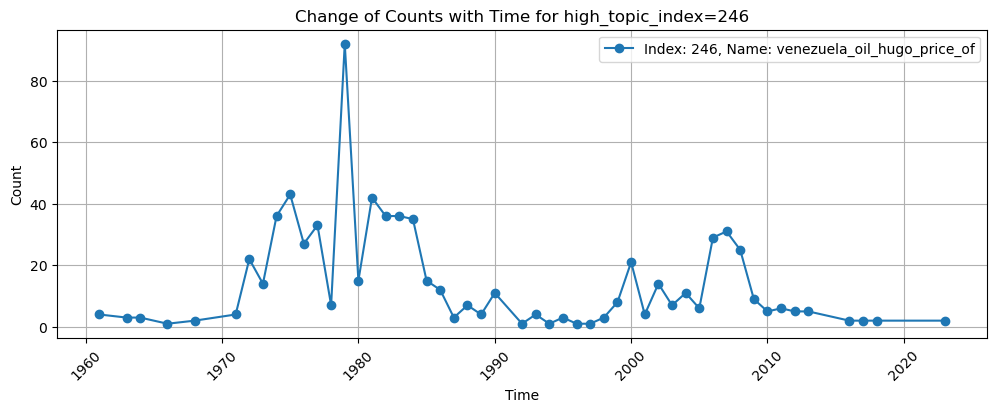

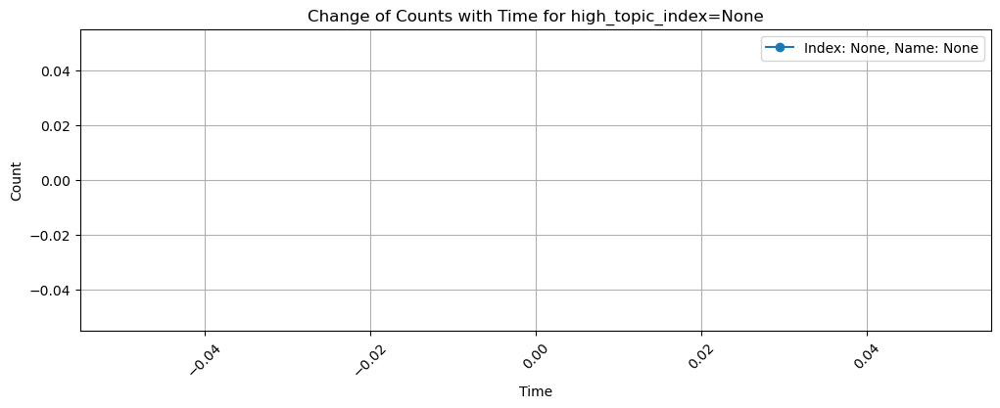

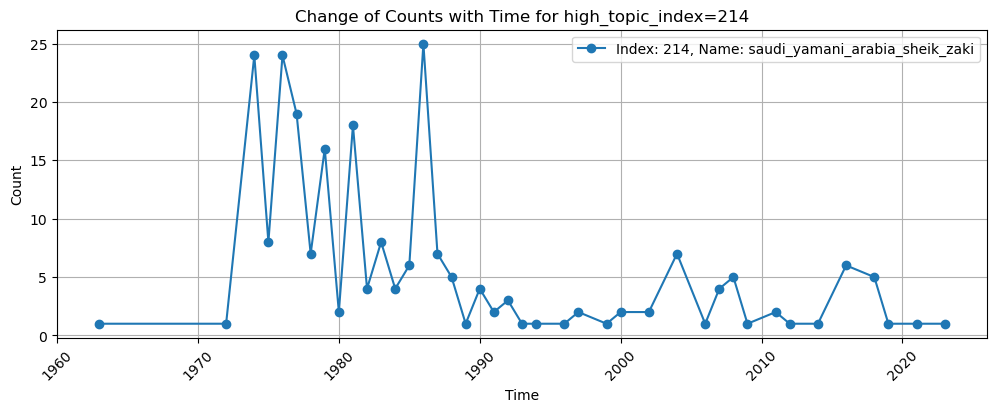

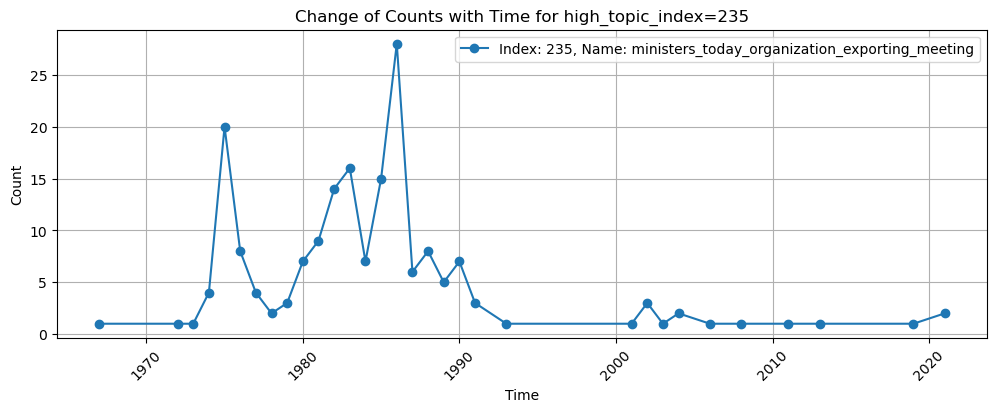

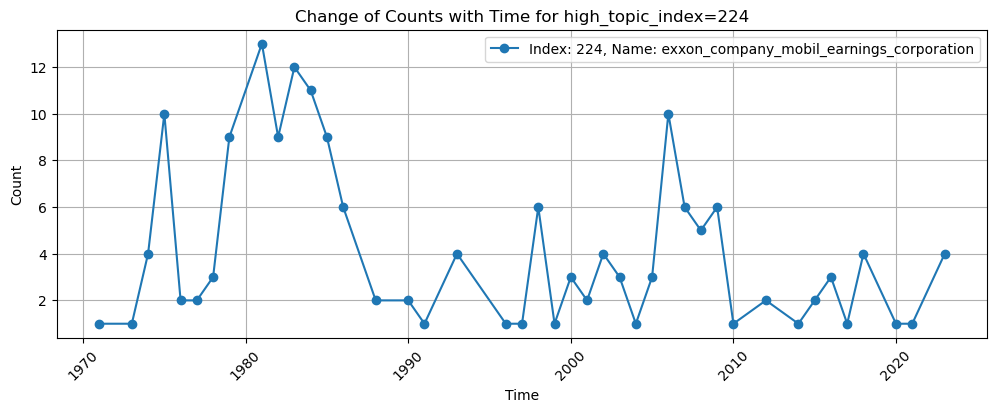

...

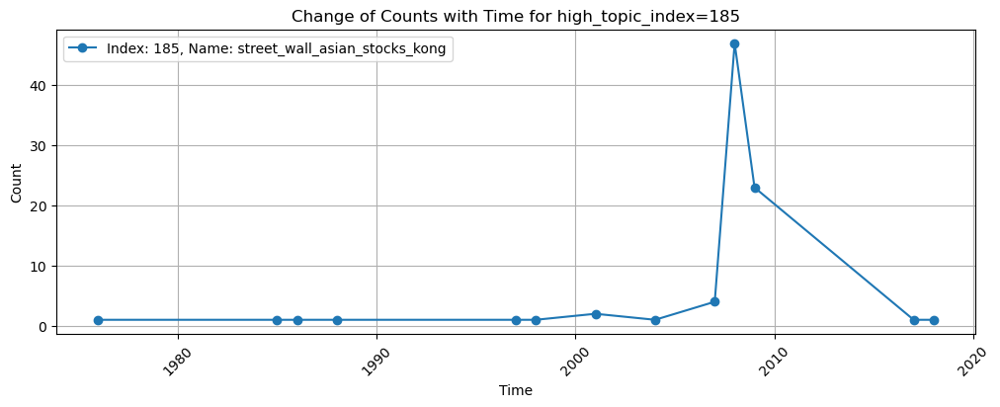

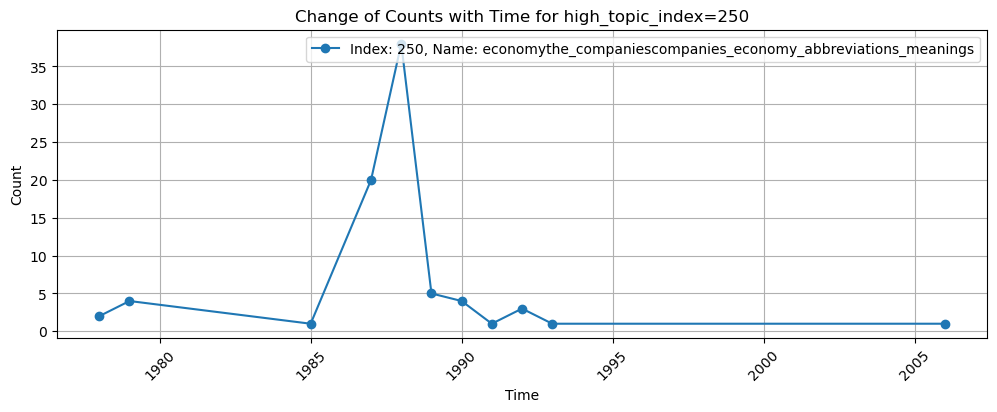

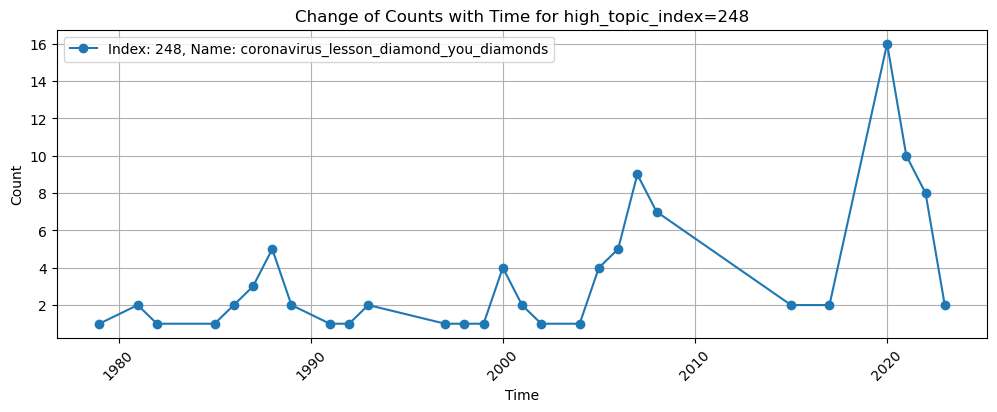

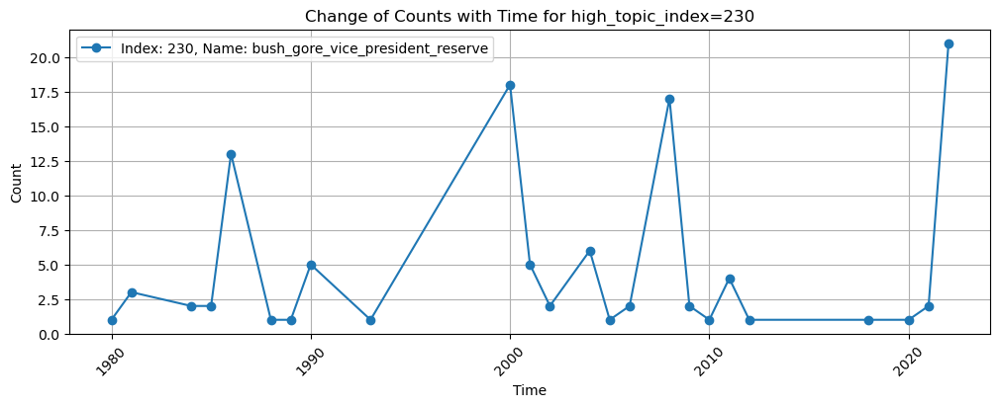

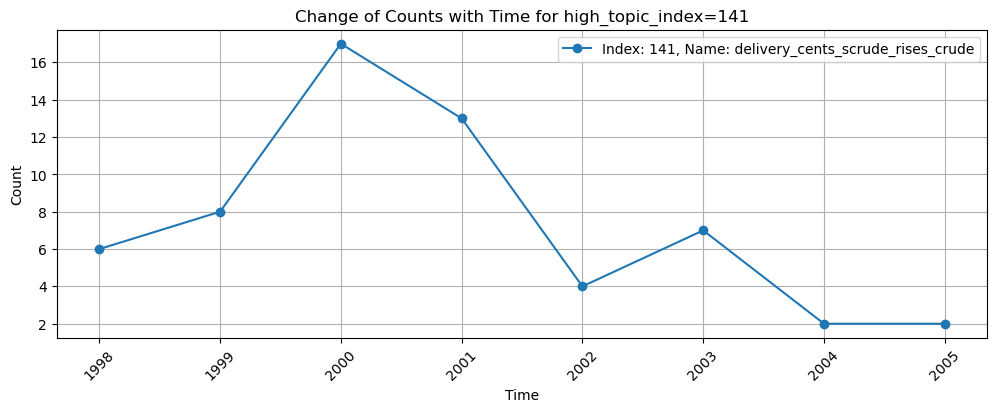

In [161]:
plot_counts_by_time_unit(df, time_unit="year")

### 3.2. Plot of the time trend with the window of month

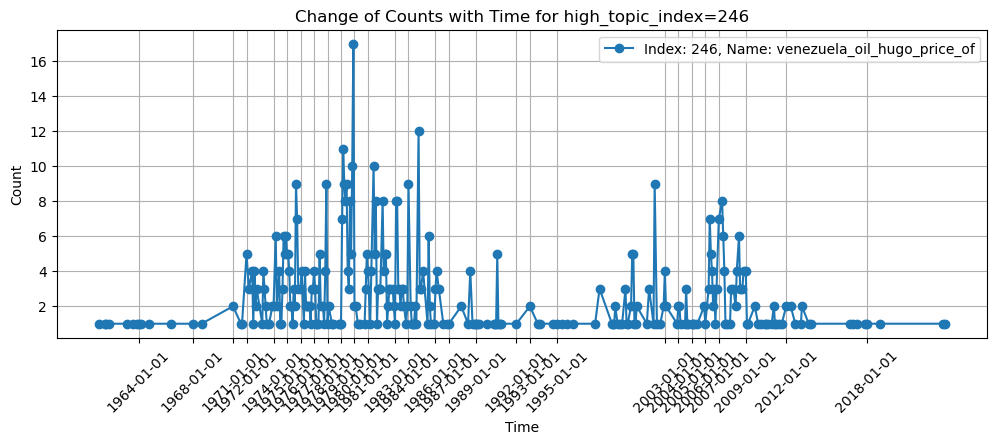

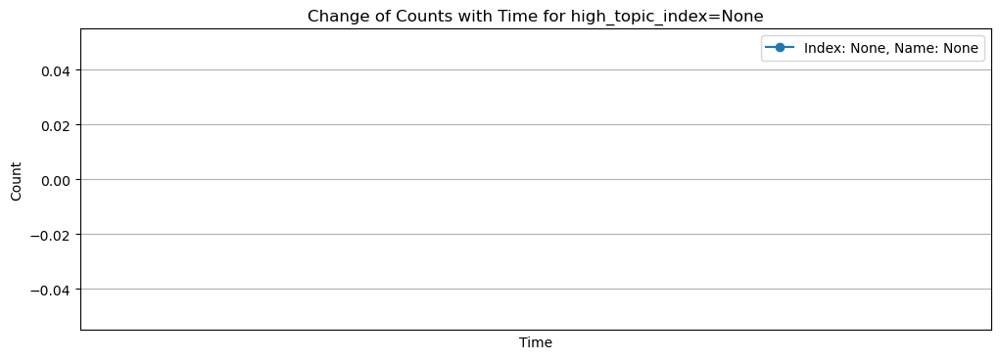

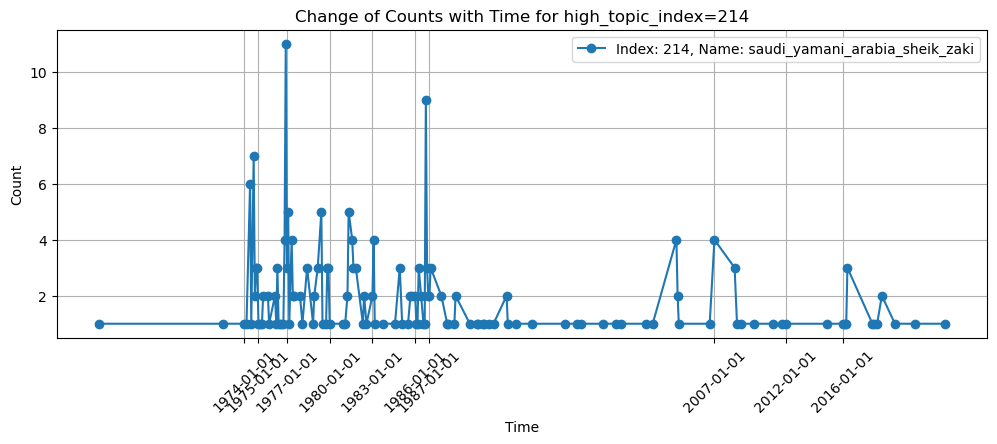

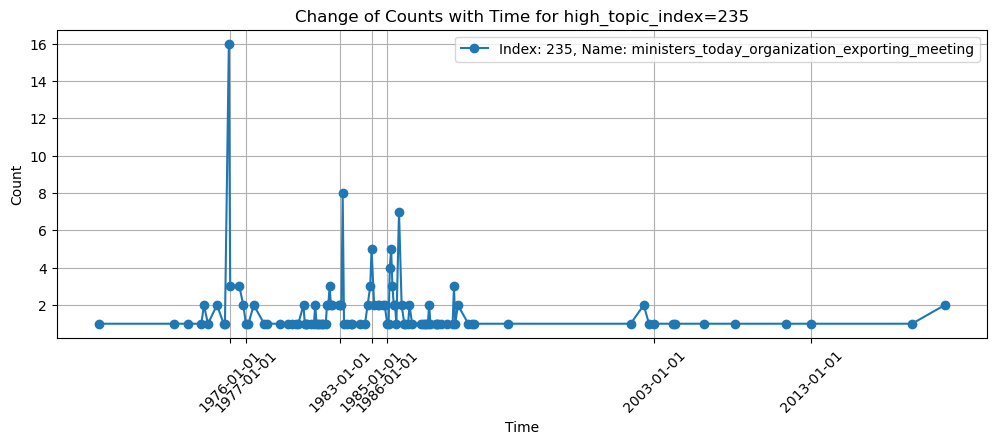

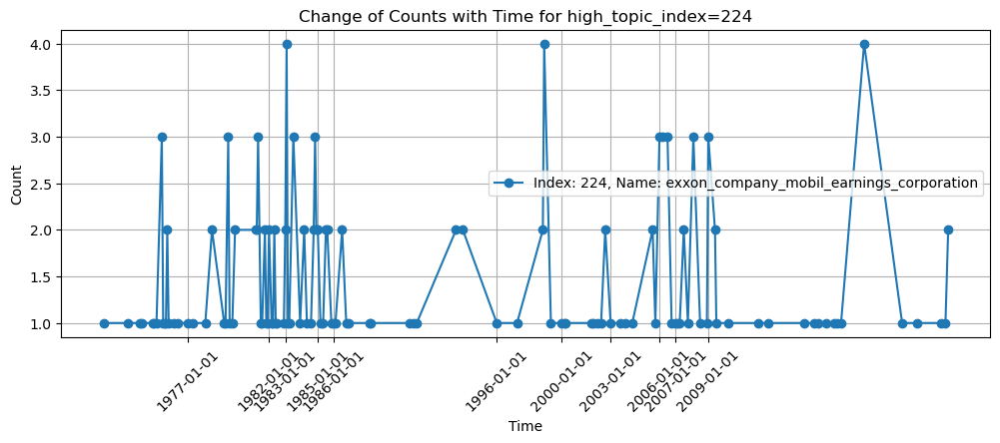

...

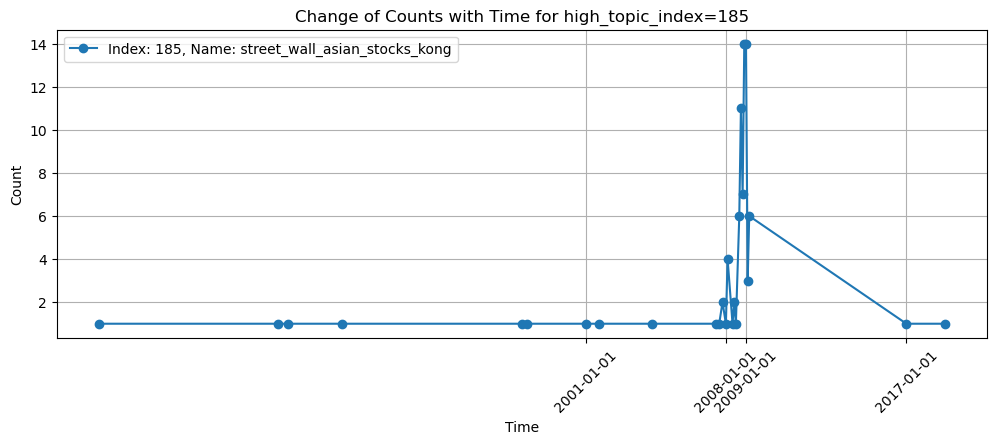

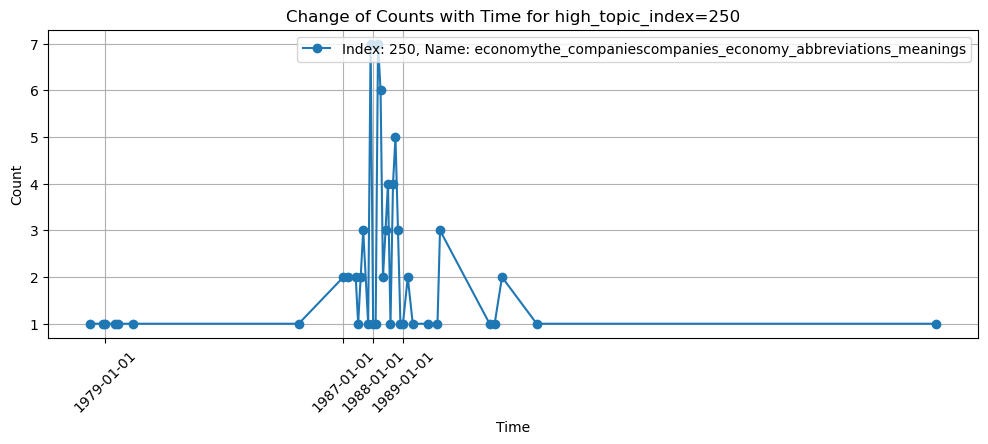

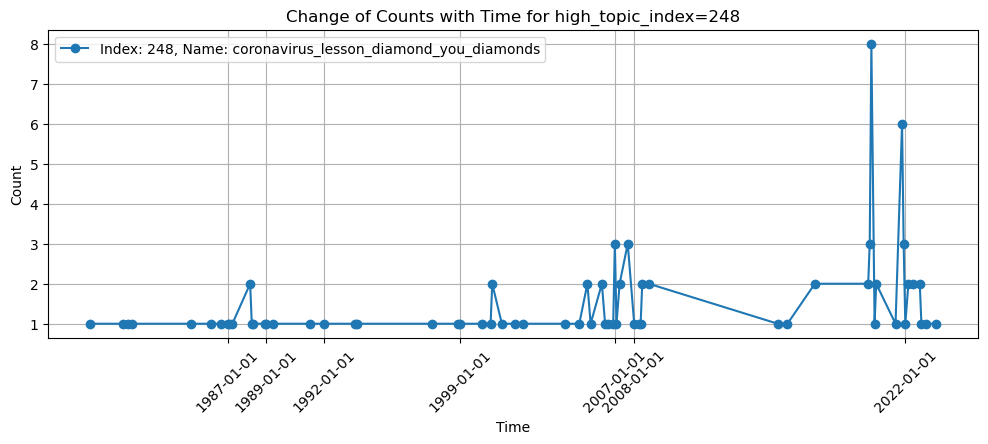

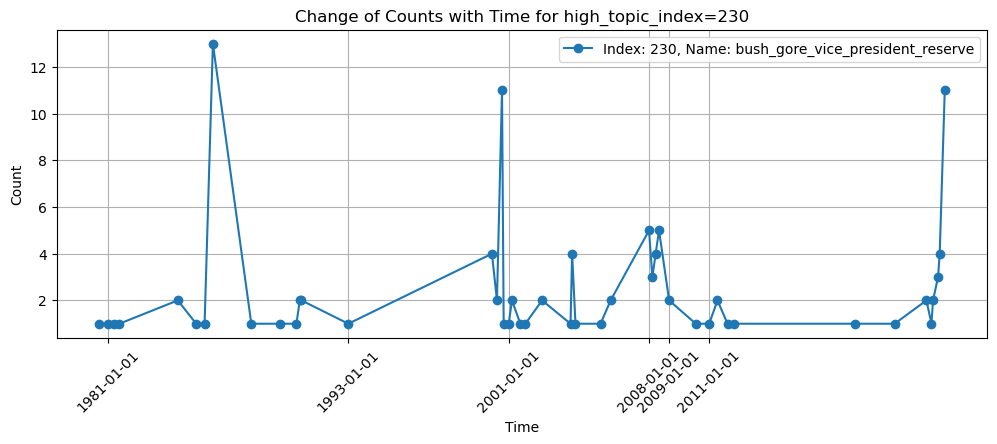

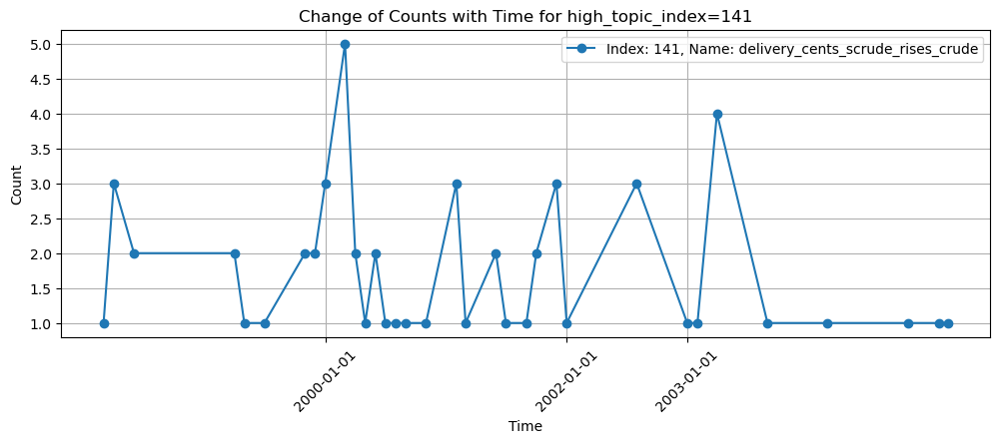

In [162]:
plot_counts_by_time_unit(df, time_unit="month")

## 4. Plot the entropy histogram

### Function for plotting

In [147]:
def plot_entropy_histogram(df, index, time_window, bin_num):
    # Check if the index argument is valid
    if index not in ['high', 'low']:
        raise ValueError("Invalid index. Use 'high' or 'low'.")

    # Check if the time_window argument is valid
    if time_window not in ['year', 'month']:
        raise ValueError("Invalid time_window. Use 'year' or 'month'.")

    # Determine the column to use as the index (either 'high_topic_index' or 'low_topic_index')
    index_column = f'{index}_topic_index'

    # Determine the column to use for time grouping ('year' or 'month')
    time_column = 'year' if time_window == 'year' else 'month'

    # Group by the chosen index and time component to compute counts
    counts = df.groupby([index_column, time_column]).size().reset_index(name='count')

    # Create a pivot table to fill missing time components with 0 counts
    pivot_counts = counts.pivot_table(index=index_column, columns=time_column, values='count', fill_value=0)

    # Calculate entropy for each index value
    def calculate_entropy(counts):
        normalized_counts = counts / counts.sum()
        return entropy(normalized_counts, base=2)

    entropy_values = pivot_counts.apply(calculate_entropy, axis=1).reset_index(name='entropy')

    # Create the df_entropy DataFrame
    df_entropy = pd.DataFrame({f'{index}_topic_index': entropy_values[f'{index}_topic_index'], 'entropy': entropy_values['entropy']})

    # Plot the histogram of entropy values
    plt.figure(figsize=(6, 4))
    plt.hist(df_entropy['entropy'], bins = bin_num, edgecolor='black', alpha=0.7)
    plt.xlabel('Entropy')
    plt.ylabel('Frequency')
    plt.title(f'Histogram of Entropy ({index.capitalize()} Index) - Time Window: {time_window.capitalize()}')
    plt.grid(axis='y')
    plt.show()

### 4.1. High + year

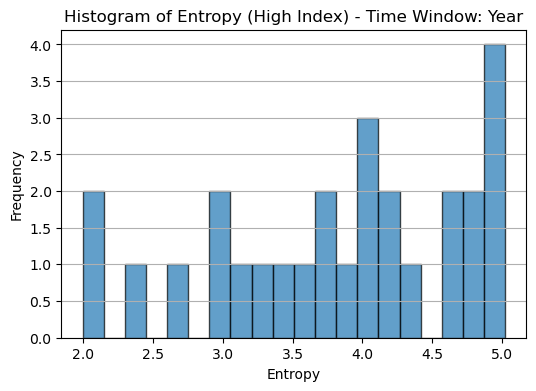

In [148]:
plot_entropy_histogram(df, index='high', time_window='year', bin_num = 20)  # Change index and time_window as needed

### 4.2. High + month

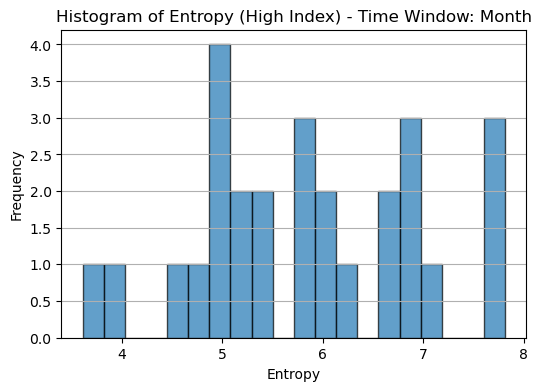

In [149]:
plot_entropy_histogram(df, index='high', time_window='month', bin_num = 20)

### 4.3. Low + year

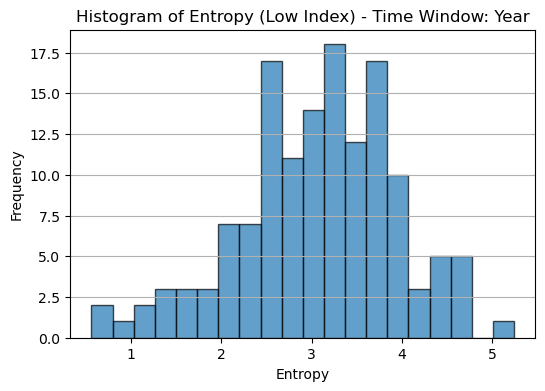

In [150]:
plot_entropy_histogram(df, index='low', time_window='year', bin_num = 20)

### 4.4. Low + month

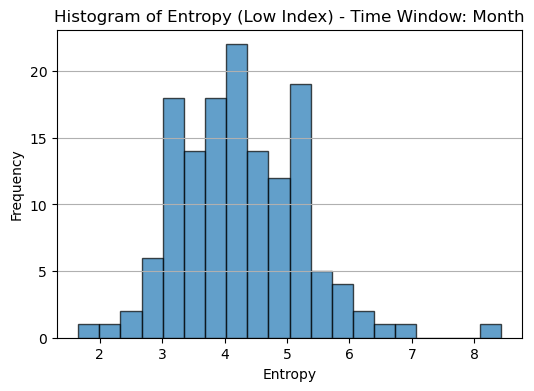

In [176]:
plot_entropy_histogram(df, index='low', time_window='month', bin_num = 20)

## 5. Export csv files for document info + topic info (교수님 공유)

In [178]:
columns_to_export = ["abstract", "snippet", "lead_paragraph", "doc", "year", "month", "low_topic_index","low_topic_name", "high_topic_index", "high_topic_name"]
df_to_export = df[columns_to_export]

In [179]:
df_to_export.to_csv("nyt_articles_with_topic_info")

## 6. Visualization

### 6.1. Standard topic visualization 

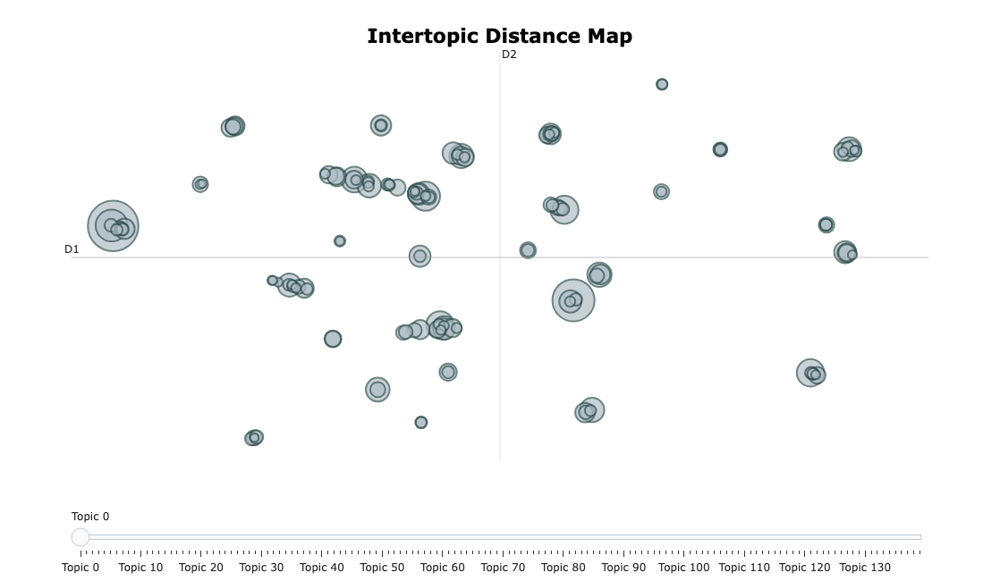

In [170]:
topic_model.visualize_topics()

### 6.2. Document visualization

In [171]:
sentence_model = SentenceTransformer("all-MiniLM-L6-v2")
embeddings = sentence_model.encode(docs, show_progress_bar=False)

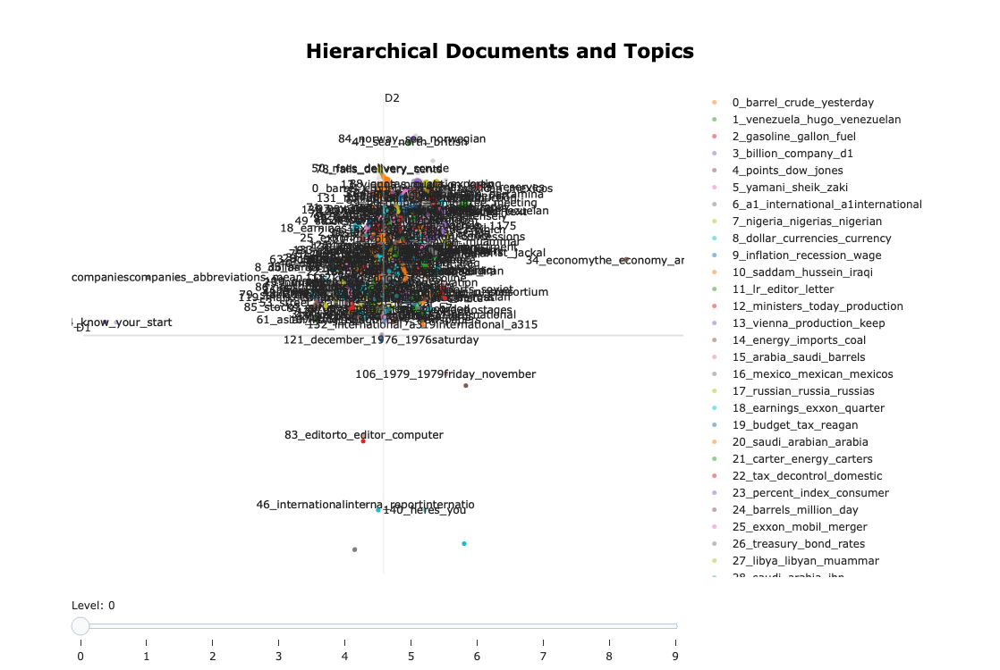

In [177]:
topic_model.visualize_hierarchical_documents(docs, hierarchical_topics, embeddings=embeddings)

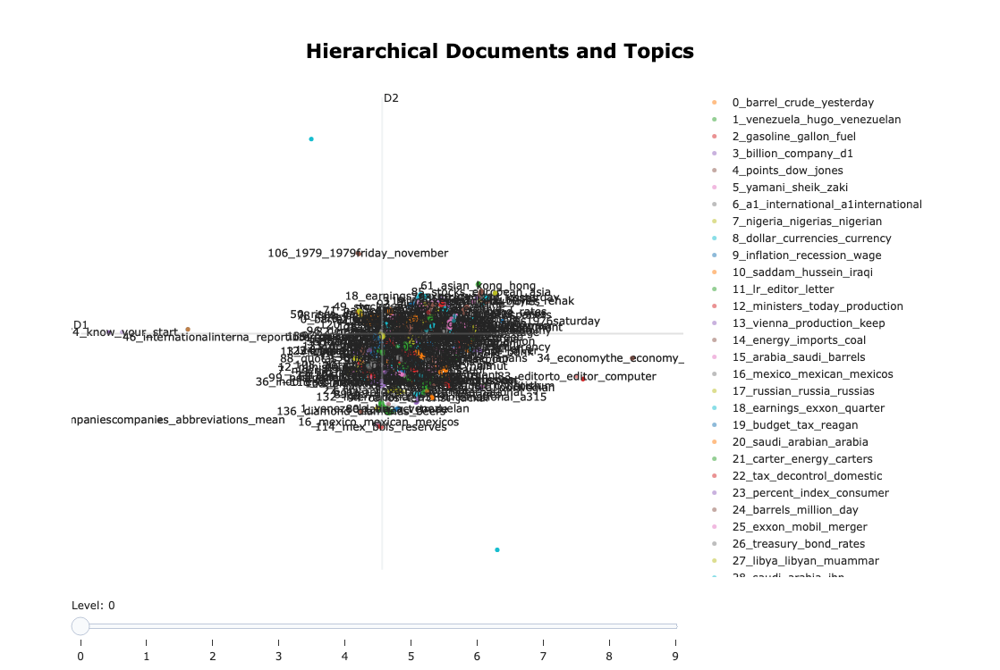

In [173]:
# Reduce dimensionality of embeddings, this step is optional but much faster to perform iteratively:
reduced_embeddings = UMAP(n_neighbors=10, n_components=2, min_dist=0.0, metric='cosine').fit_transform(embeddings)
topic_model.visualize_hierarchical_documents(docs, hierarchical_topics, reduced_embeddings=reduced_embeddings)